In [1]:
import numpy as np
import czifile
from pathlib2 import Path
import matplotlib.pyplot as plt
import cv2
from fil_finder import FilFinder2D
import astropy.units as u
import pandas as pd
from tqdm.notebook import tqdm

In [7]:
project_dir = Path('../../../data/2021.02.16')
result_dir = project_dir / 'result_dir'
data_dir = project_dir / 'input_data'
px2mum_mult = 600 / 2048

In [3]:
from forest import prepare_mask, make_skeleton, make_forest

In [4]:
def find_branching_points(skeleton):
    import scipy
    kernel = np.ones((3, 3), 'uint8')
    neighbors = cv2.filter2D((skeleton > 0).astype('uint8'), -1, kernel)
    high_degree = (skeleton > 0) & (neighbors >= 4)
    
    contours,hier = cv2.findContours(high_degree.astype('uint8'),cv2.RETR_CCOMP,cv2.CHAIN_APPROX_SIMPLE)
    branching_points = np.zeros_like(skeleton, dtype='bool')
    for cnt in contours:
        assert(cnt.shape[1] == 1)
        cnt = np.squeeze(cnt, axis = 1)
        w = scipy.spatial.distance.pdist(cnt)
        cid = np.argmin(w.sum(axis = 0))
        branching_points[cnt[cid, 1], cnt[cid, 0]] = 1
    return branching_points

def make_forest_image(img, mask, skeleton):
    import cmapy
    img = np.minimum(img / np.quantile(img, 0.999) * 256, 255)
    res = cv2.applyColorMap(img.astype('uint8'), cmapy.cmap('gray'))
    
    contours, hierarchy = cv2.findContours(mask.astype('uint8'), cv2.RETR_TREE, cv2.CHAIN_APPROX_NONE)
    cv2.drawContours(res, contours, -1, (0,80,0), 1)

    res[skeleton != 0, :] = 0
    res[skeleton != 0, 2] = 80
    
    branching_points = find_branching_points(skeleton)
    res[branching_points, :] = 0
    res[branching_points, 1:3] = 255
    
    return res

def analyze_stack(czi_filename):
    im = czifile.imread(czi_filename)
    #print(czi_filename.name, im.shape)
    im = im.reshape(im.shape[3:6])
    
    from forest import make_forest
    all_forests = []
    for i in tqdm(range(len(im))):
        img = im[i, :, :].copy()
        mask, skeleton, dist = make_forest(img)
        forest_img = make_forest_image(img, mask, skeleton)
        #print(forest_img.shape, forest_img.dtype)

        forest_img_filename = result_dir / 'forest_images' / (czi_filename.stem + '_' + str(i) + '.png')
        forest_img_filename.parent.mkdir(parents=True, exist_ok=True)
        #print(forest_img_filename)

        #cv2.imwrite(str(forest_img_filename), forest_img)
        all_forests.append([mask, skeleton, dist, forest_img])
        #break

    forests_img_filename = result_dir / 'forests' / (czi_filename.stem + '.npy')
    forests_img_filename.parent.mkdir(parents=True, exist_ok=True)
    #print(all_forests)
    #np.save(forests_img_filename, all_forests, allow_pickle = True)
    return all_forests


In [5]:
data = [
    ("Young1.czi", "young"),
    ("Old1.czi", "old"),
    ("Old2.czi", "old"),
    ("Old3.czi", "old"),
    ("Old4.czi", "old"),
]

In [8]:
all_data = []
for czi in tqdm(data):
    czi_filename = data_dir / czi[0]
    all_data.append(analyze_stack(czi_filename))
    break

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/44 [00:00<?, ?it/s]

In [11]:
for i in range(len(data)):
    np.save(result_dir / (data[i][0] + '.npy'), np.array([all_data[i], 0], dtype=object))
    break

In [12]:
all_data = []
for i in tqdm(range(len(data))):
    cur_data, _ = np.load(result_dir / (data[i][0] + '.npy'), allow_pickle = True)
    all_data += [cur_data]
    break

  0%|          | 0/5 [00:00<?, ?it/s]

In [13]:
len(all_data), type(all_data)

(1, list)

In [29]:
mask, skeleton, dist, forest_img = all_data[0][0]

'\nplt.figure(figsize = (20, 20))\nplt.imshow(dist)\nplt.colorbar()\n\nplt.figure(figsize = (20, 20))\nplt.imshow(mask)\nplt.colorbar()\n\nplt.figure(figsize = (20, 20))\nplt.imshow(skeleton)\nplt.colorbar()\n'

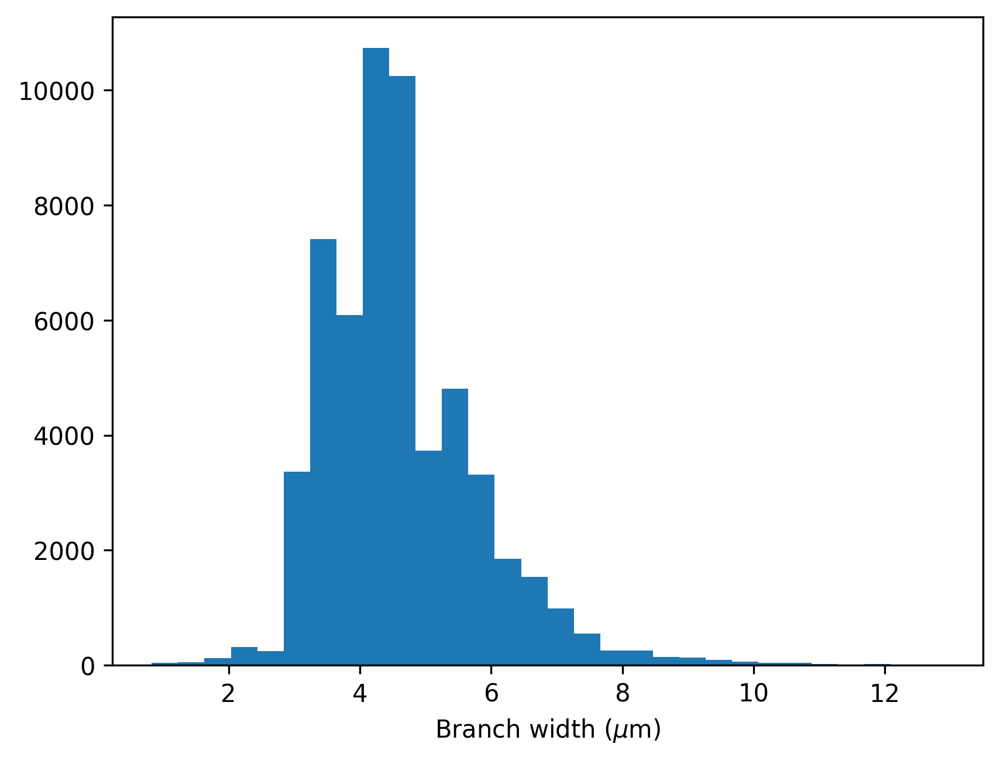

In [15]:
plt.figure(dpi = 300)
branch_widths = dist[dist > 0] * 2 * px2mum_mult
plt.hist(branch_widths, bins = 30)
plt.xlabel('Branch width ($\mu$m)')

'''
plt.figure(figsize = (20, 20))
plt.imshow(dist)
plt.colorbar()

plt.figure(figsize = (20, 20))
plt.imshow(mask)
plt.colorbar()

plt.figure(figsize = (20, 20))
plt.imshow(skeleton)
plt.colorbar()
'''

In [16]:
from matplotlib import cm
from matplotlib.colors import ListedColormap, LinearSegmentedColormap
#cmapy.cmap('viridis').shape

In [17]:
import igraph

In [47]:
from numba import njit, jit

@njit
def bfs(skeleton, pos_branching, branching_points):
    short_edges = [(0, 0)] * 0
    full_edges = [(0, 0)] * 0
    was = np.zeros_like(skeleton, 'bool')
    get_id = lambda x, y: x * skeleton.shape[0] + y
    for x, y in zip(*pos_branching):
        q = [(x, y, x, y)]
        l = 0
        while l < len(q):
            x, y, bx, by = q[l]
            if branching_points[x, y]:
                bx, by = x, y
            for cx in x - 1, x, x + 1:
                for cy in y - 1, y, y + 1:
                    if 0 <= cx < skeleton.shape[0] and 0 <= cy < skeleton.shape[1] and skeleton[cx, cy]: #and (cx, cy) != (x, y)
                        if branching_points[cx, cy]:
                            if (bx, by) != (cx, cy):
                                short_edges += [(get_id(bx, by), get_id(cx, cy))]
                        full_edges += [(get_id(x, y), get_id(cx, cy))]
                        if not was[cx][cy]:
                            q += [(cx, cy, bx, by)]
                            was[cx][cy] = True
            l += 1
    return short_edges, full_edges


def make_network(skeleton, dist):
    from time import time
    be = time()
    
    branching_points = find_branching_points(skeleton)
    en = time()
    print(en - be)

    widths = dist[branching_points] * 2 * px2mum_mult
    pos2 = np.nonzero(skeleton > 0)
    ids_skeleton = np.flatnonzero(skeleton > 0)
    pos_skeleton = np.nonzero(skeleton > 0)
    
    g_full = igraph.Graph()
    g_full.add_vertices(skeleton.size)
    
    ids_branching = np.flatnonzero(branching_points > 0)
    pos_branching = np.nonzero(branching_points > 0)
    
    g_short = igraph.Graph()
    g_short.add_vertices(skeleton.size)
    
    
    be = time()
    short_edges, full_edges = bfs(skeleton, pos_branching, branching_points)
    en = time()
    print(en - be)
    
    be = time()
    
    g_short.add_edges(list(set(short_edges)))
    g_full.add_edges(list(set(full_edges)))
    en = time()
    print(en - be)
    

    g_short.vs['pos'] = list(zip(*pos_branching))
    g_full.vs['pos'] = list(zip(*pos_skeleton))

    g_short.delete_vertices(list(set(np.arange(skeleton.size)) - set(ids_branching)))
    g_full.delete_vertices(list(set(np.arange(skeleton.size)) - set(ids_skeleton)))

    return g_short, g_full
g_short, g_full = make_network(skeleton, dist)

0.04799914360046387
0.7409980297088623


In [19]:
g_full.ecount(), skeleton.sum(), g_short.ecount()

(154652, 56513, 890)

In [20]:
def compute_network_statistics(g):
    df_network_metrics = pd.DataFrame()
    df_network_metrics['degree'] = g.degree()
    df_network_metrics['closeness'] = g.closeness()
    df_network_metrics['betweenness'] = g.betweenness()
    df_network_metrics['harmonic_centrality'] = g.harmonic_centrality()
    df_network_metrics['hub_score'] = g.hub_score()
    df_network_metrics['harmonic_centrality'] = g.harmonic_centrality()
    #df_network_metrics['harmonic_centrality'] = g.harmonic_centrality()
    df_network_statistics = df_network_metrics.describe()
    df_network_statistics = df_network_statistics.rename(index={'25%': 'Q1', '50%': 'median', '75%': 'Q3'})
    df_network_statistics = df_network_statistics.drop(index='count')
    df_network_statistics = df_network_statistics.stack().reset_index()
    #df_network_statistics['level_0'].str + '_' + df_network_statistics['level_1'].str
    df_network_statistics['feature_name'] = \
        df_network_statistics.apply(lambda x: x['level_0'] + '_' + x['level_1'], axis=1)
    
    df_network_statistics = df_network_statistics.drop(columns = ['level_0', 'level_1'])
    df_network_statistics = df_network_statistics.rename(columns={0: 'value'})
    df_network_statistics = df_network_statistics.set_index('feature_name')
    df_network_statistics = df_network_statistics.T.reset_index()

    clustering = g.connected_components()
    network_info = {
        'modularity': clustering.modularity,
        'connected_components': clustering.sizes(),
        'diameters': g.get_diameter(),
        'vertex_count': g.vcount(),
        'edge_count': g.ecount(),
        'girth': g.girth(), # the length of the shortest circle
        'reciprocity': g.reciprocity(),
        'transitivity_undirected': g.transitivity_undirected(),
    }

    network_info['max_connected_components'] = np.max(network_info['connected_components'])
    network_info['mean_connected_components'] = np.mean(network_info['connected_components'])
    network_info['cnt_connected_components'] = len(network_info['connected_components'])
    for feature_name, value in network_info.items():
        if isinstance(value, (int, float)):
            df_network_statistics.loc[0, feature_name] = value

    return df_network_metrics, df_network_statistics
#g = g_short_small.copy()
#df_network_metrics, df_network_statistics = compute_network_statistics(g)
#print(df_network_statistics.T)


In [21]:
g_short_small = g_short.copy()
to_delete_ids = [v.index for v in g_short_small.vs if v.degree() == 0]
g_short_small.delete_vertices(to_delete_ids)
print(len(to_delete_ids))

88


<AxesSubplot: >

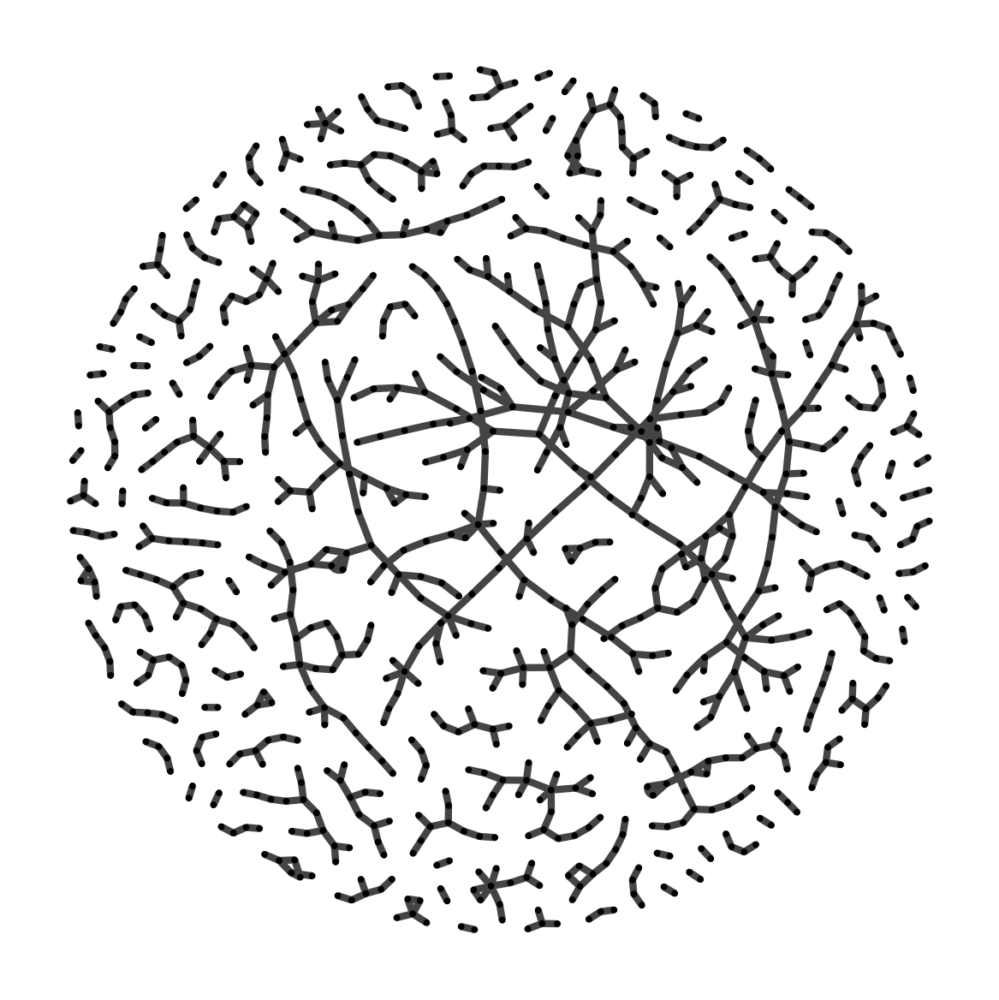

In [22]:
import matplotlib.pyplot as plt
fig, ax = plt.subplots(dpi=300)
igraph.plot(g_short_small, target=ax)

In [23]:
g_short_small.vcount(), g_short_small.ecount()

(994, 890)

In [25]:
def get_distances(all_data):
    all_dist = []
    mean_dist = []
    for i in range(len(all_data)):
        cur_dist = []
        cur_mean_dist = []
        for j in range(len(all_data[i])):
            mask, skeleton, dist, forest_img = all_data[i][j]
            cdist = dist[dist != 0] * 2 * px2mum_mult
            cur_dist.append(cdist)
            cur_mean_dist.append(cdist.mean())
        mean_dist.append(cur_mean_dist)
        all_dist.append(np.concatenate(cur_dist))
    return all_dist, mean_dist

def get_area(all_data, normalized = False):
    all_area = []
    for i in range(len(all_data)):
        cur_area = []
        for j in range(len(all_data[i])):
            mask, skeleton, dist, forest_img = all_data[i][j]
            if normalized:
                cur_area.append([mask.mean()])
            else:
                cur_area.append([mask.sum()])
        all_area.append(np.concatenate(cur_area))
    return all_area

def get_branching_points(all_data):
    all_branching = []
    all_branching_width = []
    all_mean_width = []
    for i in range(len(all_data)):
        cur_branching = []
        cur_width = []
        cur_mean_width = []
        for j in range(len(all_data[i])):
            mask, skeleton, dist, forest_img = all_data[i][j]
            
            branching_points = find_branching_points(skeleton)
            widths = dist[branching_points] * 2 * px2mum_mult
            widths = widths
            cur_width.append(widths)
            cnt_branching = (branching_points).sum()
            cur_branching.append([cnt_branching])
            cur_mean_width.append(widths.mean())
            
        all_branching.append(np.concatenate(cur_branching))
        all_branching_width.append(np.concatenate(cur_width))
        all_mean_width.append(cur_mean_width)
        
    return all_branching, all_branching_width, all_mean_width

from tqdm.notebook import tqdm
def get_networks(all_data):
    all_network_shorts = []
    all_network_full = []
    all_network_statistics = []
    for i in tqdm(range(len(all_data))):
        cur_shorts = []
        cur_full = []
        cur_network_statistics = []
        cur_network_statistics = []
        for j in tqdm(range(len(all_data[i]))):
            mask, skeleton, dist, forest_img = all_data[i][j]
            g_short, g_full = make_network(skeleton, dist)
            df_network_metrics, df_network_statistics = compute_network_statistics(g_short)
            cur_network_statistics.append(df_network_statistics)
            cur_shorts.append(g_short)
            cur_full.append(g_full)
        all_network_shorts.append(cur_shorts)
        all_network_full.append(cur_full)
        all_network_statistics.append(cur_network_statistics)
    return all_network_shorts, all_network_full, all_network_statistics
    
all_distances, mean_dist = get_distances(all_data)
all_area = get_area(all_data, normalized = True)
all_branching, all_branching_width, all_mean_width = get_branching_points(all_data)
all_network_shorts, all_network_full, all_network_statistics = get_networks(all_data)

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/44 [00:00<?, ?it/s]

In [22]:
feature_names = all_network_statistics[0][0].columns
df_all_network_statistics = []
for i in range(len(all_network_statistics)):
    df_all_network_statistics += [pd.concat(all_network_statistics[i], ignore_index=True)]

C:\Users\MIKE_L~1\AppData\Local\Temp/ipykernel_21228/3978969961.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure()


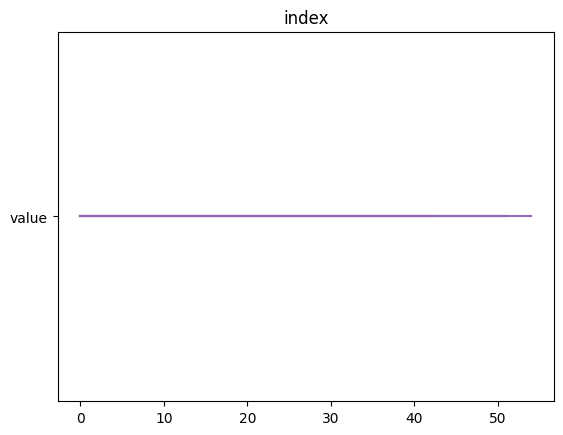

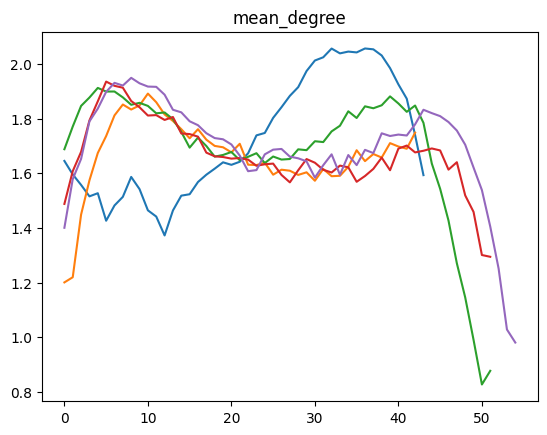

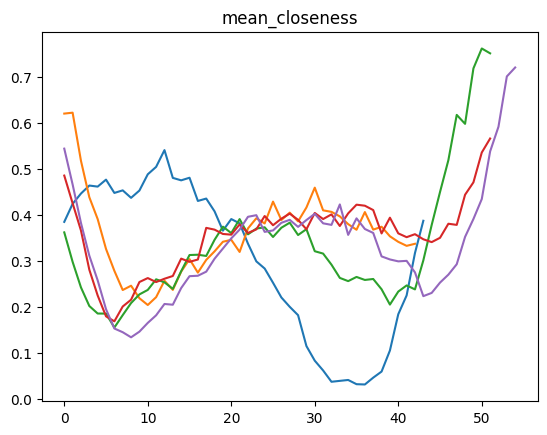

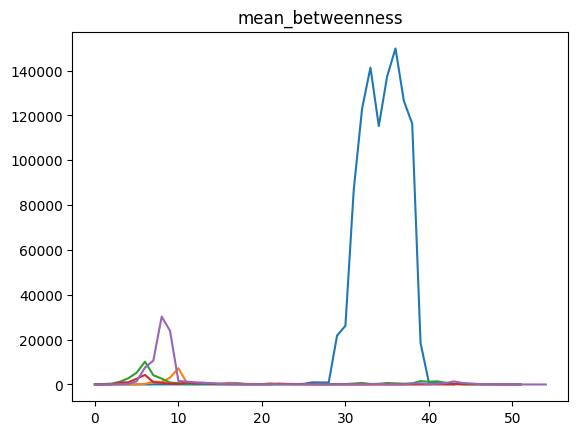

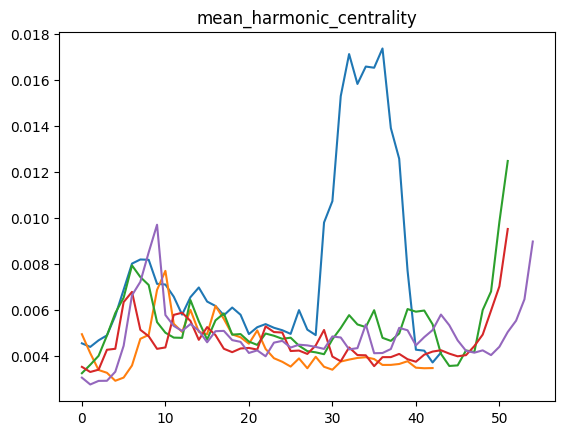

...

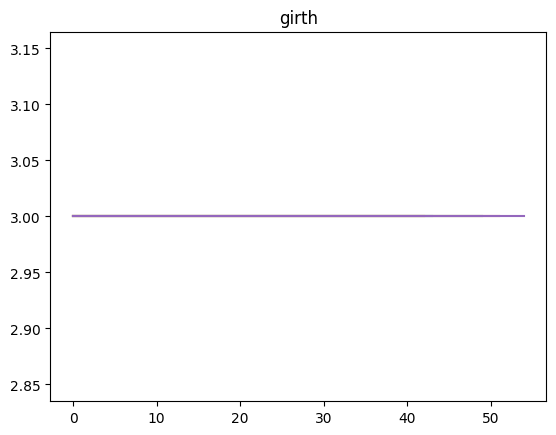

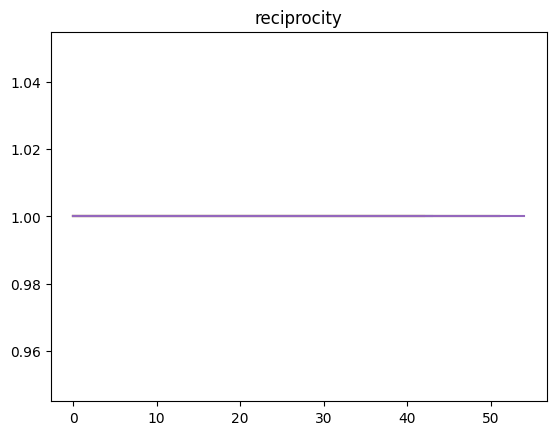

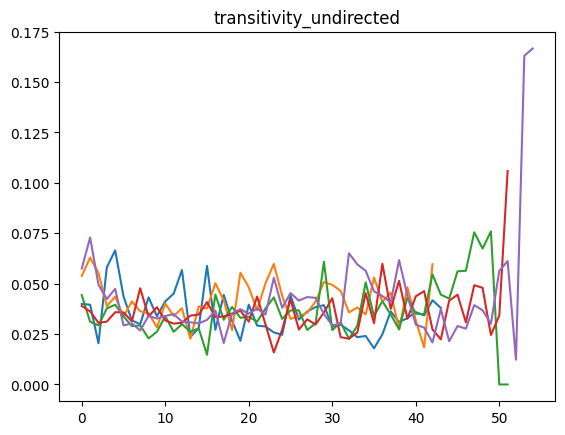

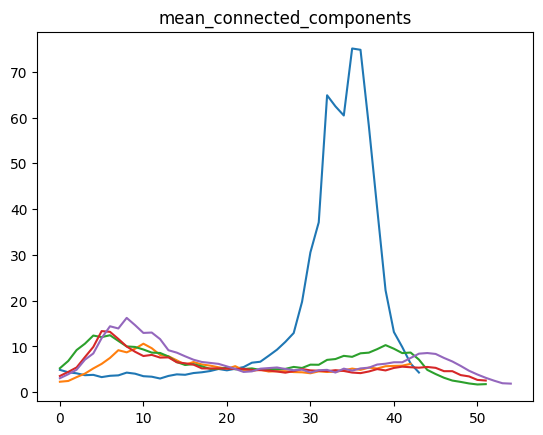

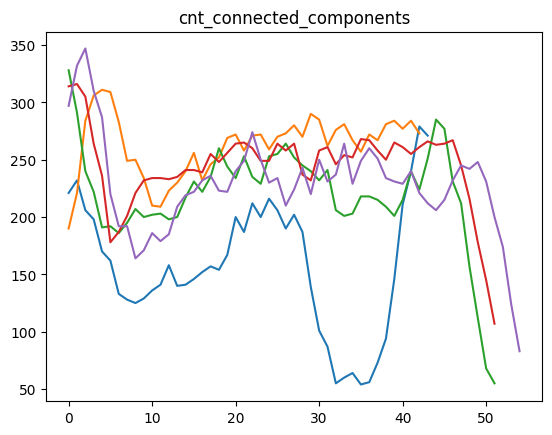

In [23]:
for feature_name in feature_names:
    plt.figure()
    for i in range(len(all_network_statistics)):
        df = pd.concat(all_network_statistics[i])
        plt.plot(df_all_network_statistics[i][feature_name])
    plt.title(feature_name)
    break

In [24]:
all_branching[i]

NameError: name 'all_branching' is not defined

In [26]:
list(map(np.mean, all_branching))

[1693.5227272727273,
 1483.3023255813953,
 1507.923076923077,
 1405.3461538461538,
 1509.509090909091]

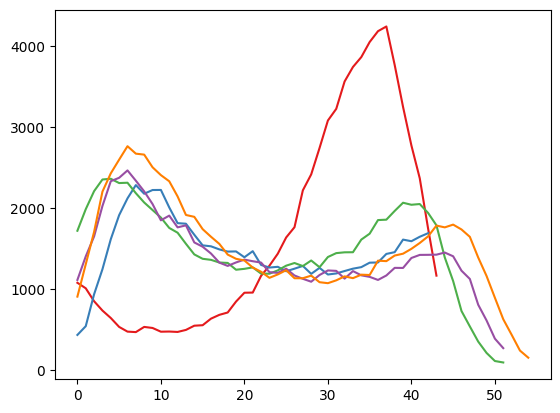

In [60]:
for i in range(len(all_branching)):
    plt.plot(all_branching[i])

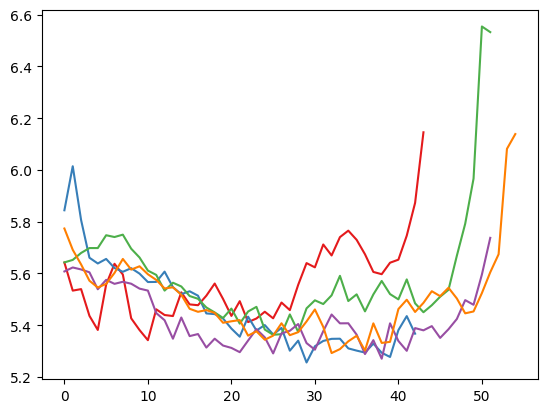

In [39]:
for i in range(len(all_mean_width)):
    plt.plot(all_mean_width[i])

<AxesSubplot: >

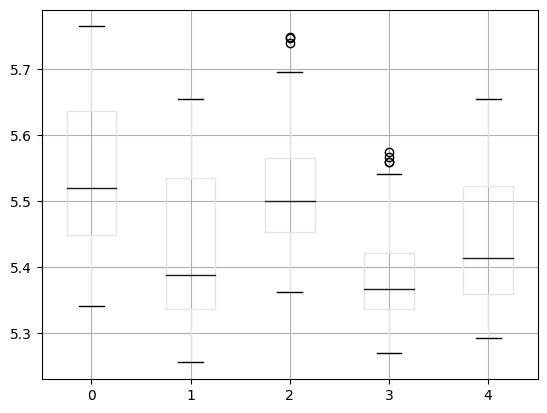

In [45]:
df = pd.DataFrame(all_mean_width).T
df.loc[5:40].boxplot()

In [50]:
all_mean_width[0]

[5.641907278361587,
 5.533385170068082,
 5.539199050587996,
 5.435977372984468,
 5.381421683504627,
 5.556696234851955,
 5.637009470586089,
 5.595577908414215,
 5.426371486171884,
 5.381068676244297,
 5.341939467756838,
 5.46117403719376,
 5.43916383465582,
 5.435180054873277,
 5.526733277504334,
 5.4801381861238205,
 5.4770551247699455,
 5.513787191973375,
 5.560740045946201,
 5.5013514925150355,
 5.435686927202077,
 5.492667969370084,
 5.41177177318412,
 5.425732417970336,
 5.451808239602042,
 5.426450365013628,
 5.4873670578951685,
 5.4580968633592875,
 5.555791291478613,
 5.639710772278815,
 5.623315884129263,
 5.711575730456452,
 5.669208041875378,
 5.74005149150846,
 5.76503121915823,
 5.729567258812404,
 5.673756720993565,
 5.605511115992484,
 5.596876318899254,
 5.641209594375792,
 5.652931636007265,
 5.74569005065578,
 5.872411841360158,
 6.145022470924845]

In [53]:
df_all_mean_width[0]

0     5.641907
1     5.533385
2     5.539199
3     5.435977
4     5.381422
5     5.556696
6     5.637009
7     5.595578
8     5.426371
9     5.381069
10    5.341939
11    5.461174
12    5.439164
13    5.435180
14    5.526733
15    5.480138
16    5.477055
17    5.513787
18    5.560740
19    5.501351
20    5.435687
21    5.492668
22    5.411772
23    5.425732
24    5.451808
25    5.426450
26    5.487367
27    5.458097
28    5.555791
29    5.639711
30    5.623316
31    5.711576
32    5.669208
33    5.740051
34    5.765031
35    5.729567
36    5.673757
37    5.605511
38    5.596876
39    5.641210
40    5.652932
41    5.745690
42    5.872412
43    6.145022
44         NaN
45         NaN
46         NaN
47         NaN
48         NaN
49         NaN
50         NaN
51         NaN
52         NaN
53         NaN
54         NaN
Name: 0, dtype: float64

In [57]:
import scipy.stats as stats
df_all_mean_width = pd.DataFrame(all_mean_width).T
df_all_mean_width = df_all_mean_width.loc[5:40]
all_mean_widths_tuple = df_all_mean_width[0], df_all_mean_width[1], df_all_mean_width[2], df_all_mean_width[3], df_all_mean_width[4]
fvalue, pvalue = stats.f_oneway(*all_mean_widths_tuple)
print(pvalue)

group_names = list(map(lambda x: x[1], data))
widths = zip(group_names, all_mean_widths_tuple)
mean_widths = []
group_labels = []
for group_name, mean_width in widths:
    mean_widths += mean_width.tolist()
    group_labels += [group_name] * len(mean_width)
df_widths = pd.DataFrame({'width': mean_widths, 'labels': group_labels})

from statsmodels.stats.multicomp import pairwise_tukeyhsd
m_comp = pairwise_tukeyhsd(endog=df_widths['width'], groups=df_widths['labels'], alpha=0.05)
print(m_comp)

2.3680274608279482e-09
Multiple Comparison of Means - Tukey HSD, FWER=0.05
group1 group2 meandiff p-adj lower  upper  reject
-------------------------------------------------
   old  young   0.0978   0.0 0.0565 0.1391   True
-------------------------------------------------


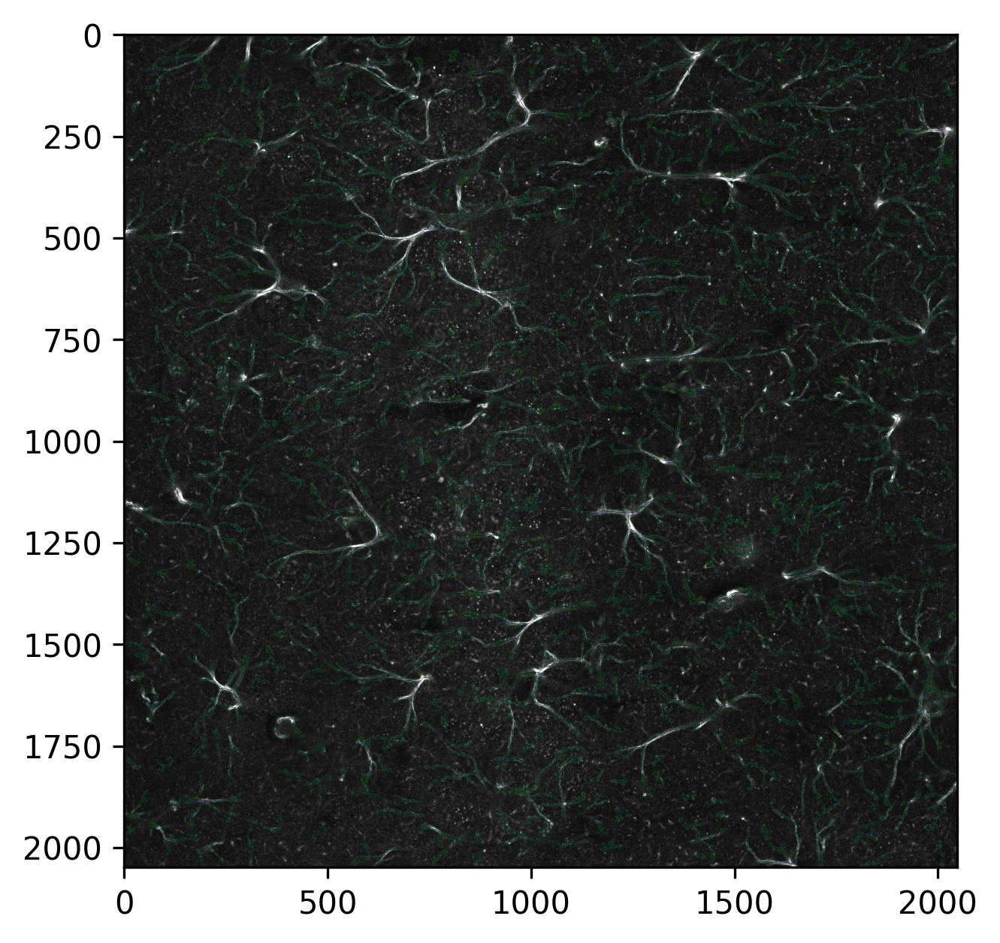

In [26]:
mask, skeleton, dist, forest_img = all_data[1][35]
plt.figure(dpi=300)
plt.imshow(forest_img)

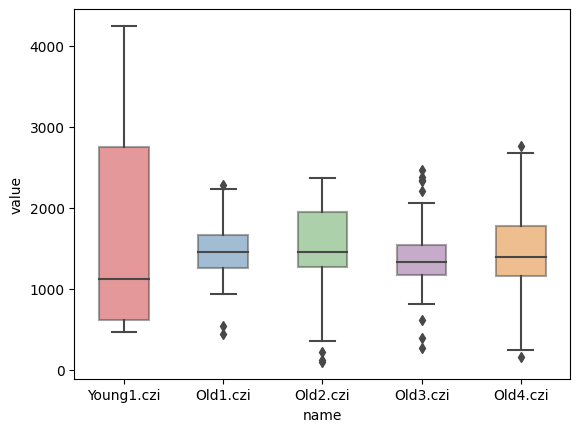

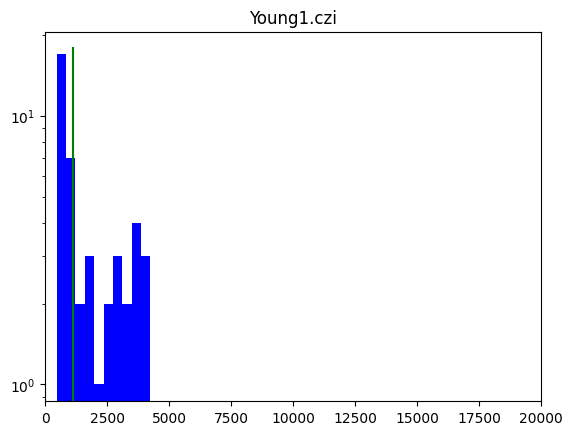

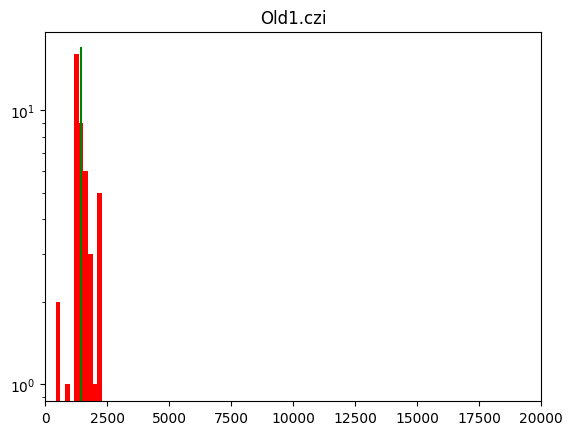

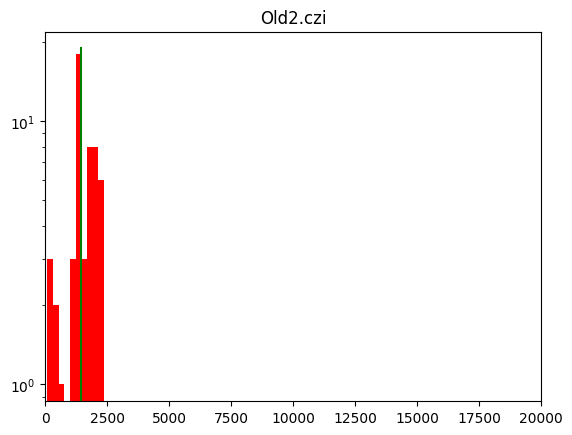

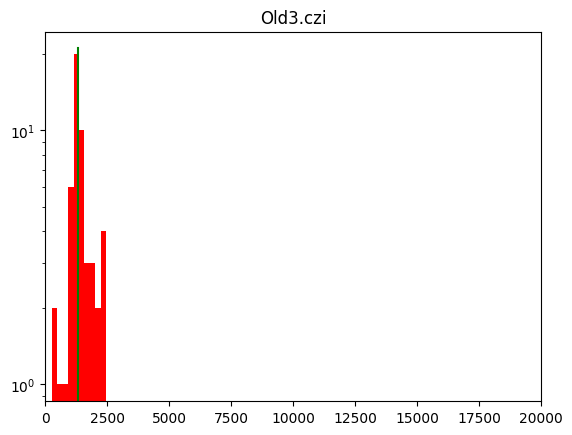

...

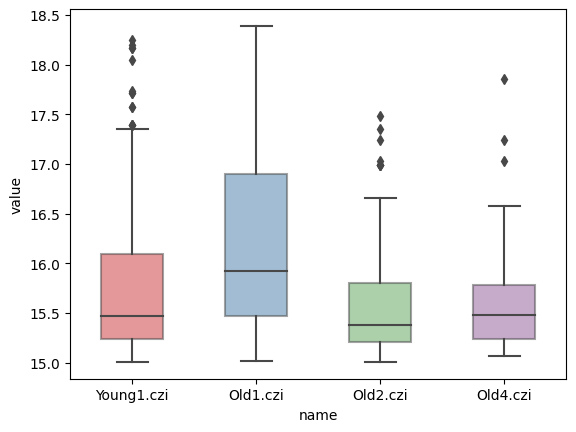

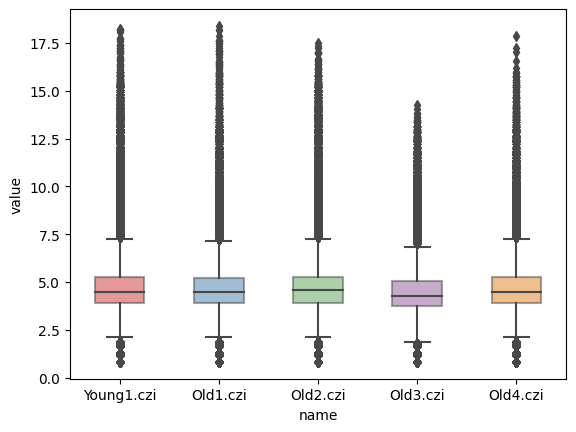

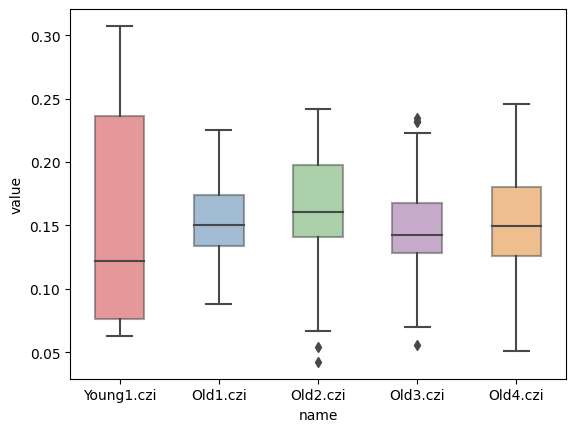

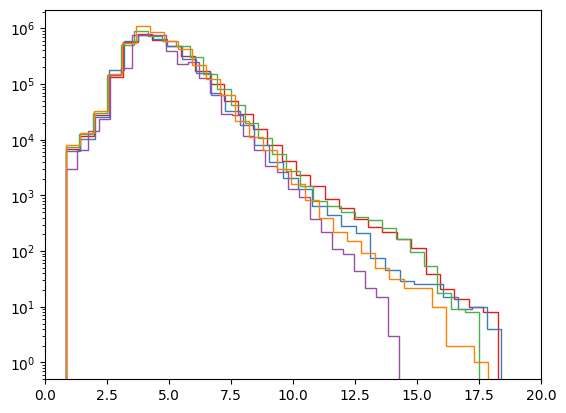

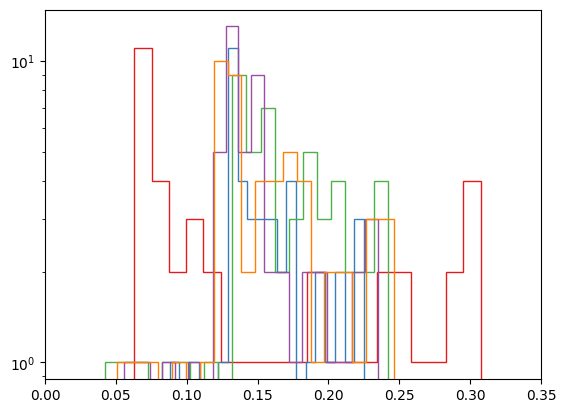

In [13]:
def make_boxplot(data_info, all_distances):
    df_data = pd.DataFrame()
    for (cur_name, cur_type), cur_data in zip(data_info, all_distances):
        df_data = df_data.append(pd.DataFrame({'value': cur_data, 'name': cur_name}), ignore_index=True)
    import seaborn as sns
    fig = plt.figure()
    ax = plt.gca()
    sns.set_palette(sns.color_palette("Set1", 12))
    bx = sns.boxplot(x = 'name', y = 'value', data = df_data, width = 0.5, boxprops=dict(alpha=.5), ax = ax)
    
def make_hist(data_info, all_distances, xlim, bins = 20, ylogscale = True):
    import seaborn as sns
    fig = plt.figure()
    for (cur_name, cur_type), cur_data in zip(data_info, all_distances):
        #plt.hist(cur_data, color = 'b' if cur_type == 'young' else 'r', bins = bins)
        #sns.kdeplot(cur_data, label = cur_name, bw = 0.5)
        plt.hist(cur_data, bins = bins, label = cur_name, histtype = 'step')
        #mn = np.median(cur_data)
        #plt.plot([mn, mn], plt.ylim(), 'g')
        #plt.title(cur_name)
        plt.xlim(xlim)
        if ylogscale:
            plt.yscale('log')

def make_hist_many(data_info, all_distances, xlim, bins = 20, ylogscale = True):
    import seaborn as sns
    
    for (cur_name, cur_type), cur_data in zip(data_info, all_distances):
        fig = plt.figure()
        plt.hist(cur_data, color = 'b' if cur_type == 'young' else 'r', bins = bins)
        mn = np.median(cur_data)
        plt.plot([mn, mn], plt.ylim(), 'g')
        plt.title(cur_name)
        plt.xlim(xlim)
        if ylogscale:
            plt.yscale('log')

make_boxplot(data, all_branching)
make_hist_many(data, all_branching, xlim = [0, 2e4], bins = 10)
#make_hist_many(data, all_area, xlim = [0, 0.35], bins = 20)
            
make_boxplot(data, all_branching_width)
make_hist(data, all_branching_width, xlim = [0, 20], bins = 30, ylogscale = True)

make_boxplot(data,  list(map(lambda x: x[x > 12], all_branching_width)))
make_hist(data, list(map(lambda x: x[x > 12], all_branching_width)), xlim = [10, 20], bins = 7, ylogscale = True)

#make_boxplot(data, all_branching)

make_boxplot(data, list(map(lambda x: x[x > 15], all_distances)))

make_boxplot(data, all_distances)
make_boxplot(data, all_area)
make_hist(data, all_distances, xlim = [0, 20], bins = 30, ylogscale = True)
make_hist(data, all_area, xlim = [0, 0.35], bins = 20)


(2048, 2048)


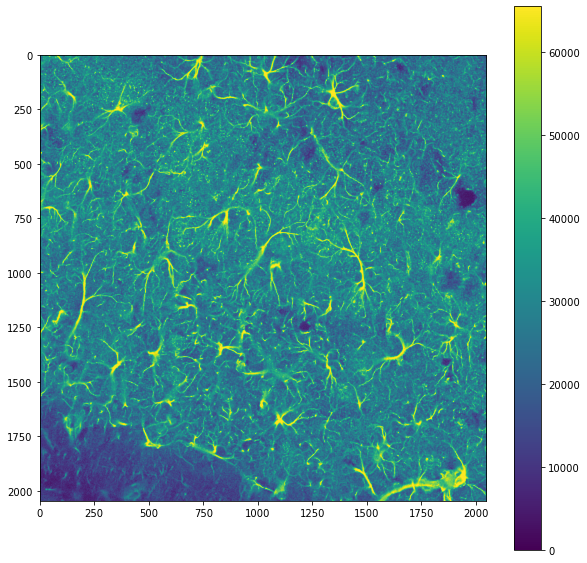

In [202]:

plt.figure(figsize = (10, 10))
#plt.imshow(im[40, :, :])
mask = (im[40, :, :] > 3000).astype('uint8')
cur = np.log(im[40, :, :].astype('float64'))
cur -= cur.min()
mx = 2 ** 16 - 1
cur *= mx / np.quantile(cur.flatten(), 0.99)
cur = np.minimum(cur, mx)
cur = cur.astype('uint16')
print(cur.shape)
plt.imshow(cur)
plt.colorbar()

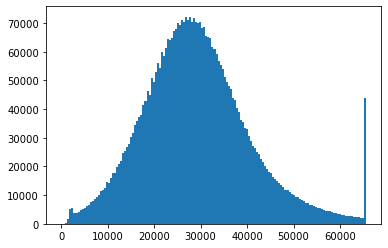

In [206]:
plt.hist(cur.flatten(), bins = 150)
#plt.yscale('log')
#plt.xscale('log')
pass

In [188]:
cur.dtype

dtype('float32')

In [25]:
skeleton.shape

(2048, 2048)

In [16]:
(im[40, :, :] > 4000).dtype

dtype('bool')

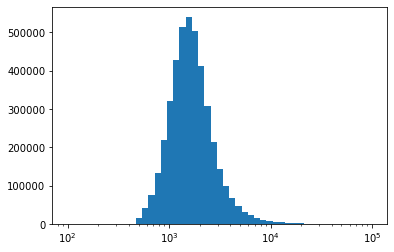

In [17]:
plt.hist(im[40, :, :].flatten(), bins = np.logspace(2, 5))
#plt.yscale('log')
plt.xscale('log')
pass

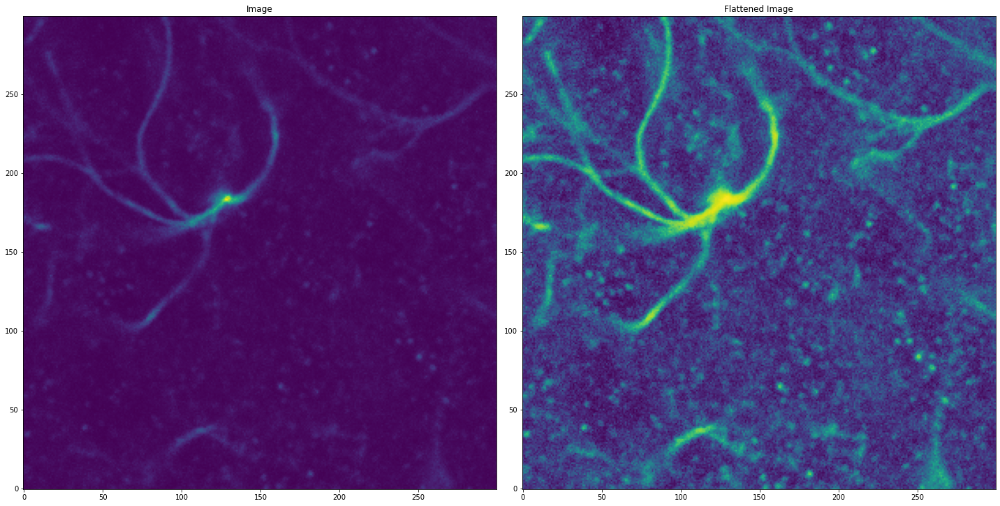

In [74]:
tid = 44
skeleton = (im[tid, :, :] > 3000).astype('uint8')
skeleton = im[tid, :, :]
skeleton = skeleton[:300, :300]

fil = FilFinder2D(skeleton, distance=250 * u.pc) # , mask=skeleton
fil.preprocess_image(flatten_percent=95)
plt.figure(figsize = (20, 10))
plt.subplot(121)
plt.imshow(fil.image.value, origin='lower')
plt.title("Image")
plt.subplot(122)
plt.imshow(fil.flat_img.value, origin='lower')
plt.title("Flattened Image")
plt.tight_layout()

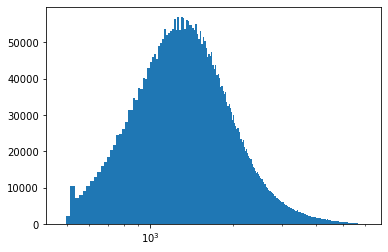

In [20]:
plt.hist(fil.flat_img.value.flatten(), bins = 300)
#plt.yscale('log')
plt.xscale('log')
pass

1
2
3
4


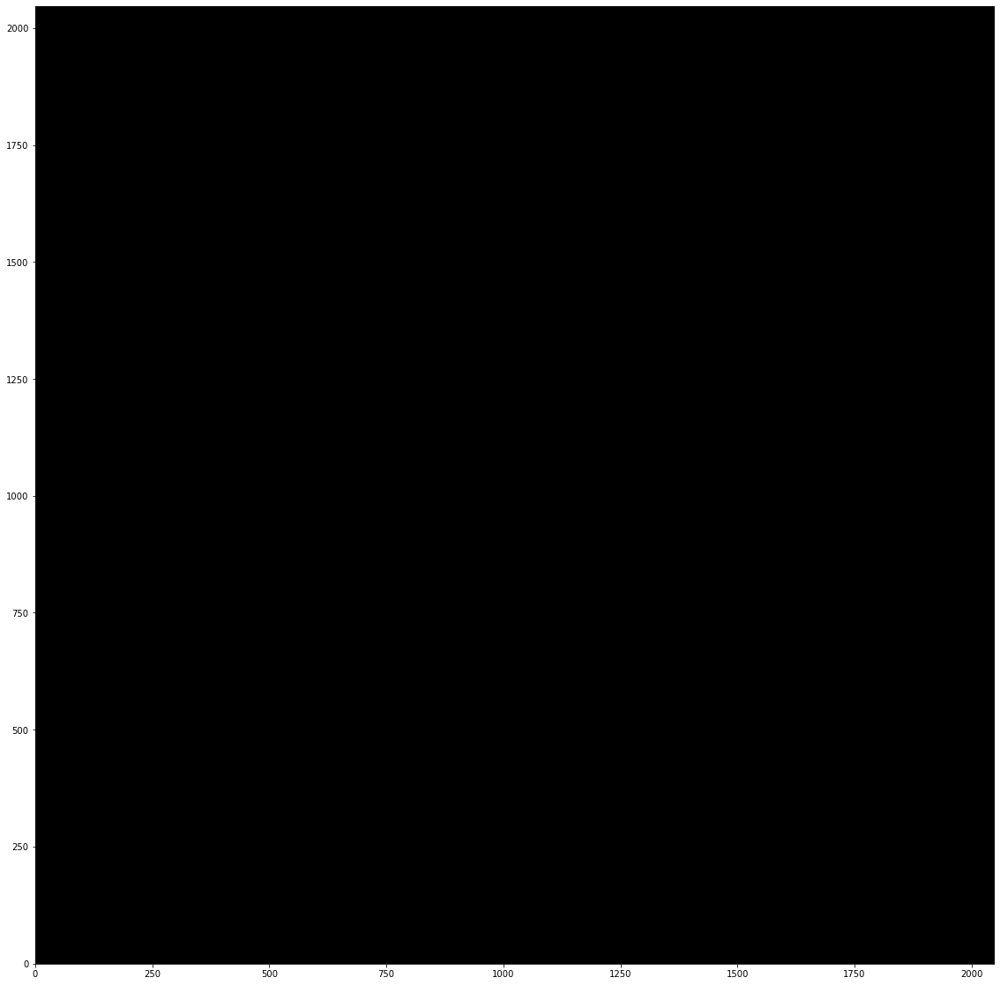

In [242]:
fil = FilFinder2D(skeleton, distance=250 * u.pix) # , mask=skeleton
print(1)
fil.preprocess_image(flatten_percent=95)
print(2)
fil.create_mask(verbose=False,\
                smooth_size = 5 * u.pix, adapt_thresh = 7 * u.pix, \
                size_thresh = 300 * u.pix ** 2, fill_hole_size = 3000 * u.pix ** 2)
#use_existing_mask=False, border_masking=False, 
print(3)
#fil.medskel(verbose=False)
print(4)
#fil.analyze_skeletons(branch_thresh=40* u.pix, skel_thresh=10 * u.pix, prune_criteria='length')
#print(5)

cur = fil.flat_img.value.copy()
#cur[cur < thr] = 0

cur = remove_alone(cur, num_iter = 100)
#cur = remove_small(cur, min_size = 300)
#cur = remove_small(cur, min_size = 300)

cur = fill_holes(cur)

plt.figure(figsize = (20, 20))
cur = remove_small(cur, min_size = 50)
plt.imshow(cur, cmap='gray', origin='lower')

# Show the longest path
#plt.figure(figsize = (20, 20))
#plt.imshow(fil.skeleton, cmap='gray', origin='lower')
#plt.contour(fil.skeleton_longpath, colors='r')
#plt.axis('off')
plt.show()

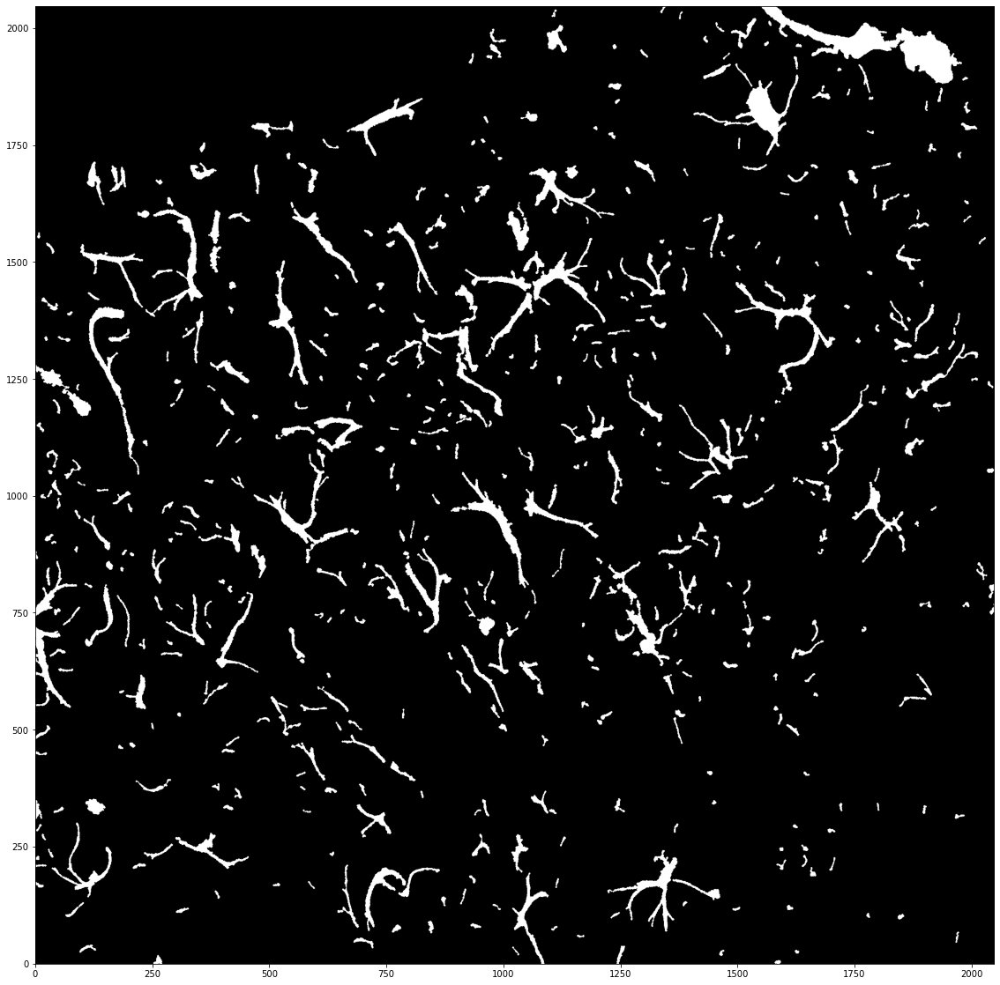

In [251]:
cur = fil.flat_img.value.copy()
thr = 3000
cur[cur < thr] = 0

cur = remove_alone(cur, num_iter = 100)
#cur = remove_small(cur, min_size = 300)
#cur = remove_small(cur, min_size = 300)

cur = fill_holes(cur > 0)

plt.figure(figsize = (20, 20))
cur = remove_small(~cur, min_size = 50)
plt.imshow(cur, cmap='gray', origin='lower')

[[0 0 1 0 0 0 0 1 1 1]
 [1 1 1 0 1 0 0 1 0 1]
 [1 0 0 0 1 1 0 1 0 1]
 [1 0 1 1 0 1 0 1 0 1]
 [0 0 1 0 0 0 0 1 1 0]
 [0 0 1 1 0 0 1 0 0 0]
 [1 1 1 0 0 1 1 0 0 1]
 [0 1 1 1 0 1 0 1 1 0]
 [1 1 1 0 1 0 1 0 0 1]
 [0 1 0 1 1 0 0 0 0 1]]
[[0 0 1 0 0 0 0 0 1 1]
 [0 1 0 0 0 0 0 0 0 1]
 [1 0 0 0 1 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0]
 [0 0 1 0 0 0 0 0 0 0]
 [0 0 1 0 0 0 0 0 0 0]
 [1 1 1 0 0 0 1 0 0 0]
 [0 1 1 1 0 1 0 0 0 0]
 [1 1 1 0 1 0 0 0 0 0]
 [0 1 0 1 0 0 0 0 0 0]]


In [262]:
cv2.imwrite(r'D:\PC\UNN\Science\Astrocytes\Programs\astro_graph\0.png', skeleton)

True

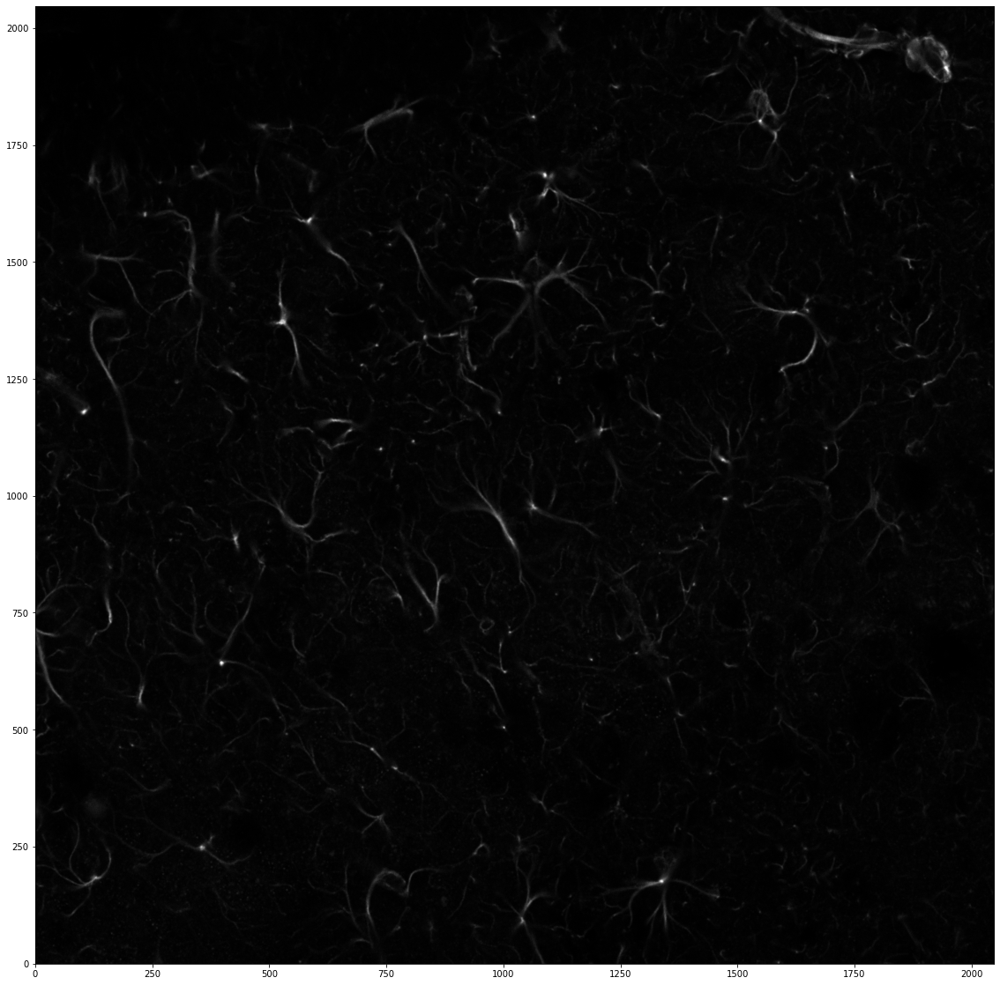

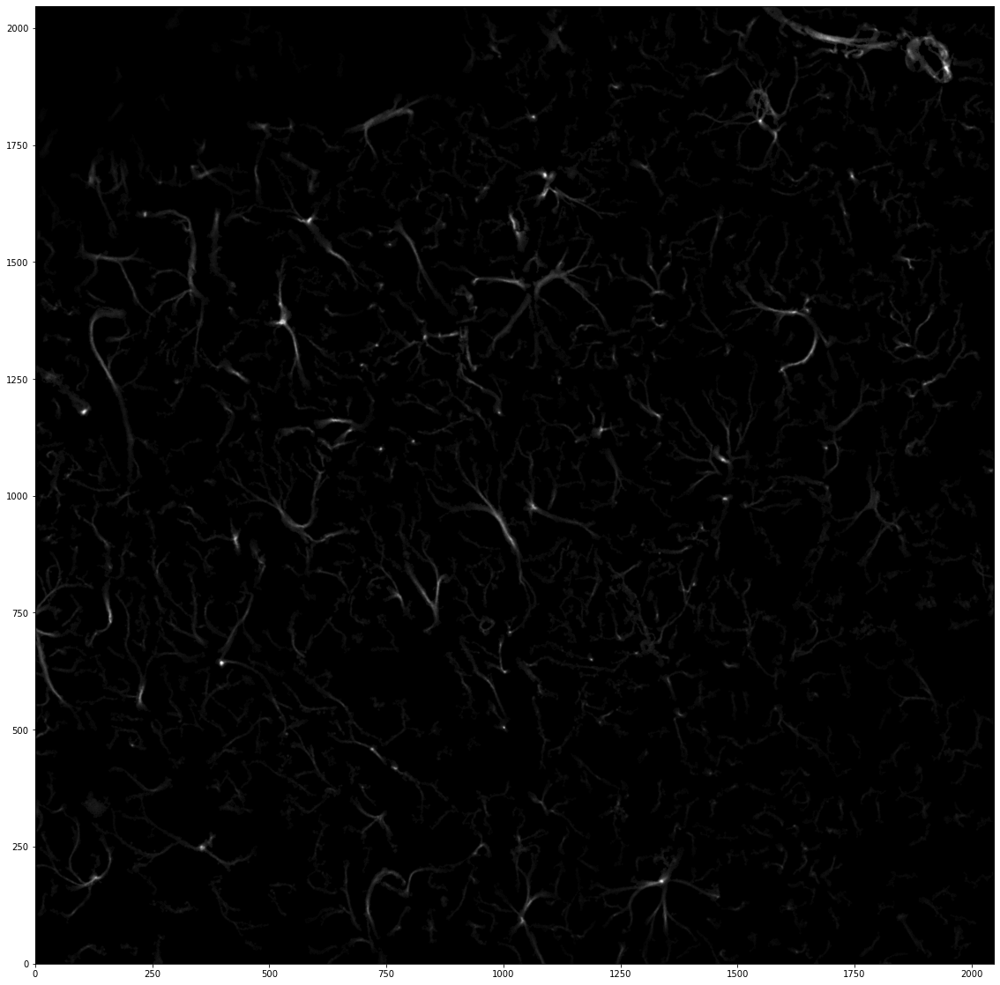

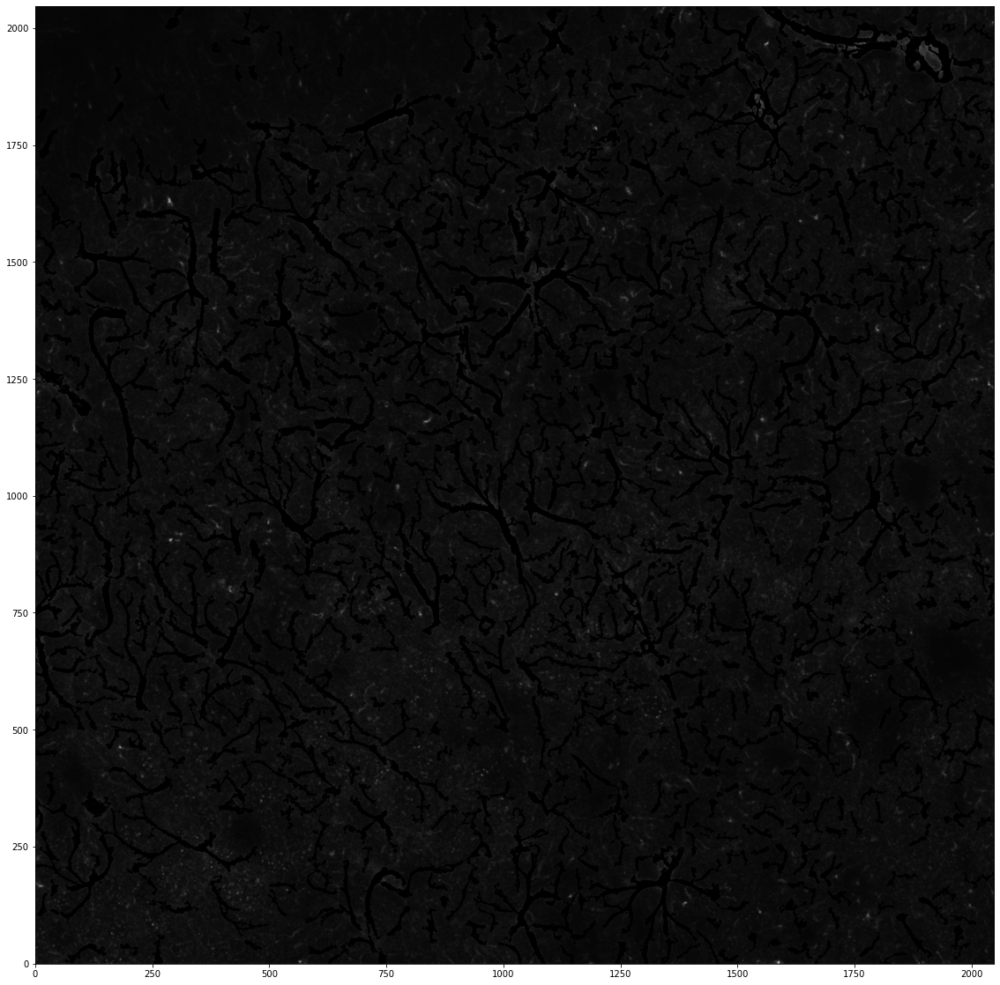

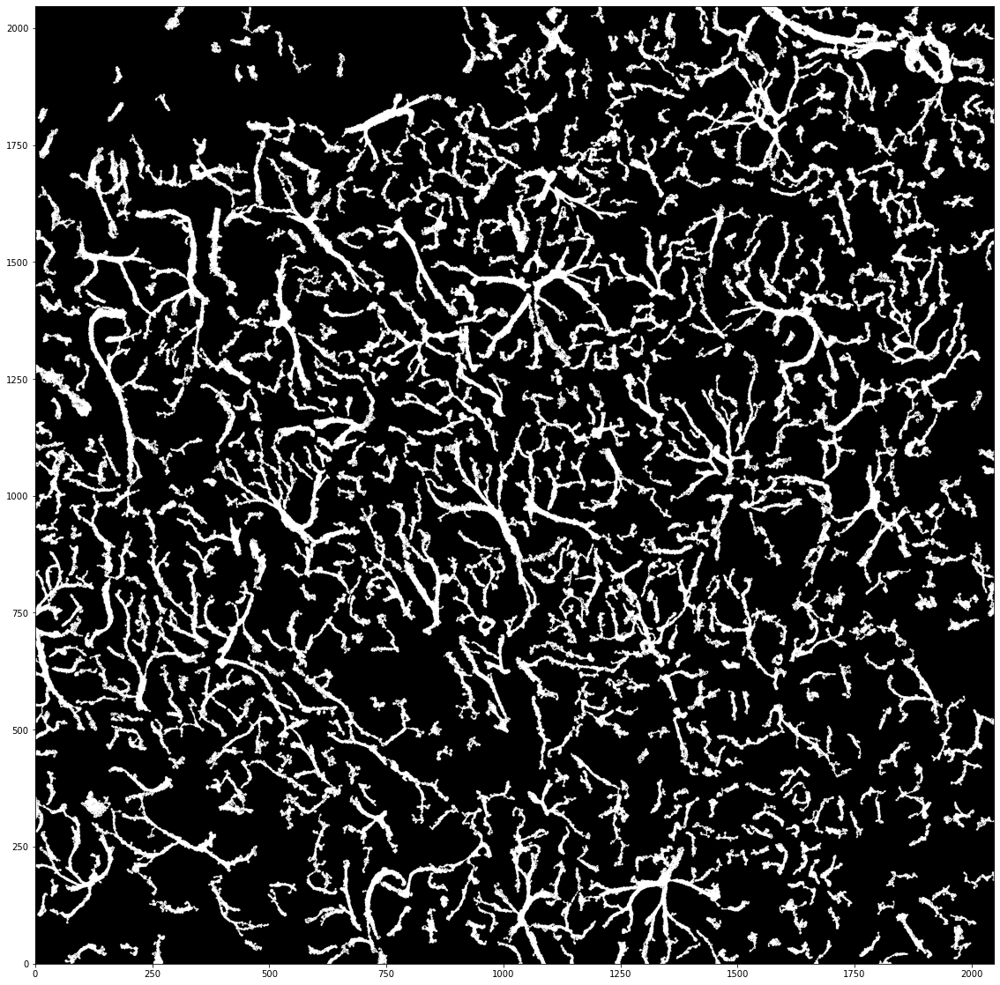

In [310]:
skeleton = im[tid, :, :]

cur = np.log(skeleton.astype('float64'))
cur -= cur.min()
mx = 2 ** 16 - 1
cur *= mx / np.quantile(cur.flatten(), 0.99)
cur = np.minimum(cur, mx)
cur = cur.astype('uint16')
#import scipy
#x = cur.flatten()
#print(np.quantile(x, [0.25, 0.5, 0.8]))

#cur = fil.flat_img.value.copy()

thr = np.quantile(x, 0.7)

#cur[cur < thr] = 0

cur = cv2.adaptiveThreshold((cur / 256).astype('uint8'), maxValue = 1, adaptiveMethod = cv2.ADAPTIVE_THRESH_MEAN_C, \
                      thresholdType = cv2.THRESH_BINARY, blockSize = 41, C = -1)

cur = remove_small(cur, min_size = 50)

cur = remove_alone(cur, num_iter = 100)
#cur = remove_small(cur, min_size = 300)
#cur = remove_small(cur, min_size = 300)

#cur = fill_holes(cur)
cur = remove_small(cur, min_size = 300)
#kernel = np.ones((3,3),np.uint8)
#erosion = cv2.erode(cur,kernel,iterations = 1)
#cur = cv2.morphologyEx(cur, cv2.MORPH_OPEN, kernel)

im_structure = skeleton.copy()
im_structure[cur == 0] = 0

plt.figure(figsize = (20, 20))
plt.imshow(skeleton, cmap='gray', origin='lower')


plt.figure(figsize = (20, 20))

#plt.imshow(cur, cmap='gray', origin='lower')
plt.imshow(im_structure, cmap='gray', origin='lower')

plt.figure(figsize = (20, 20))
im_structure = skeleton.copy()
im_structure[cur != 0] = 0
plt.imshow(im_structure, cmap='gray', origin='lower')

plt.figure(figsize = (20, 20))
plt.imshow(cur, cmap='gray', origin='lower')


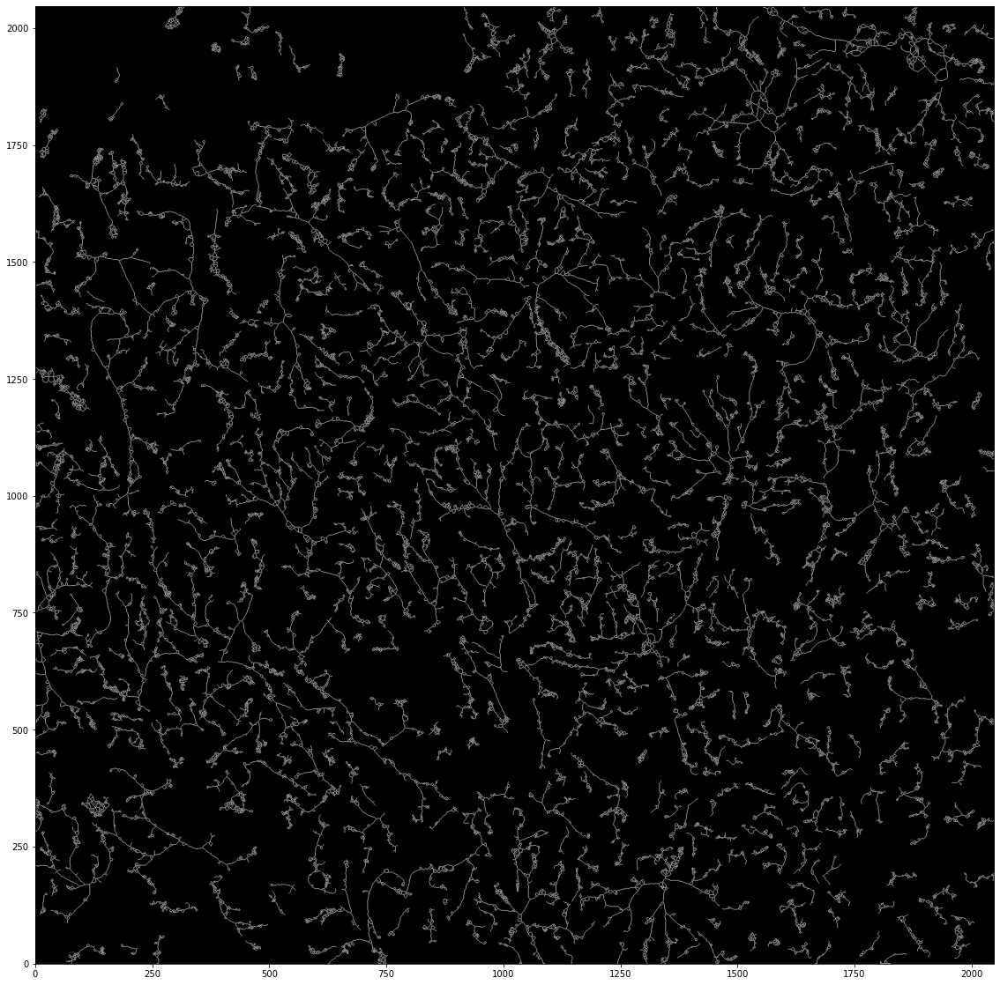

In [314]:
im_structure = skeleton.copy()
im_structure[cur == 0] = 0
fil = FilFinder2D(im_structure, distance=250 * u.pix, mask=im_structure)
fil.medskel(verbose=False)
plt.figure(figsize = (20, 20))
plt.imshow(fil.skeleton, cmap='gray', origin='lower')


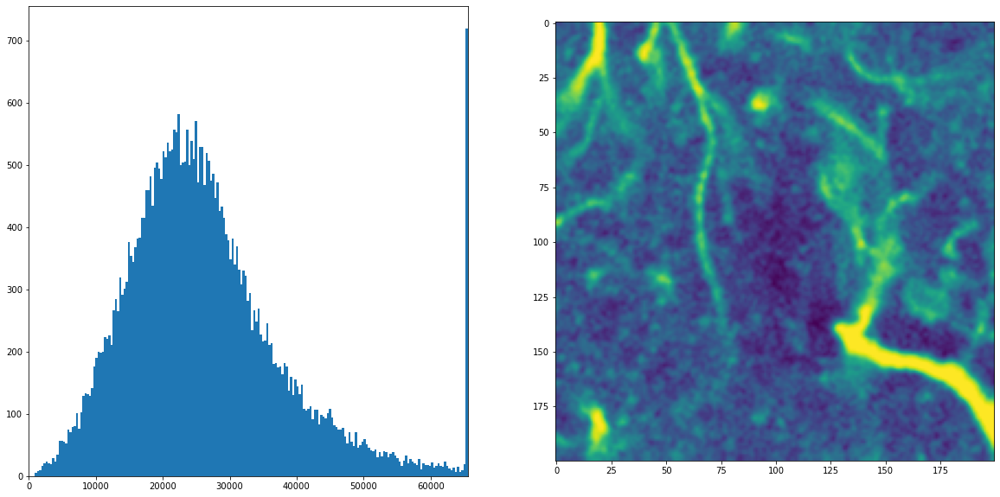

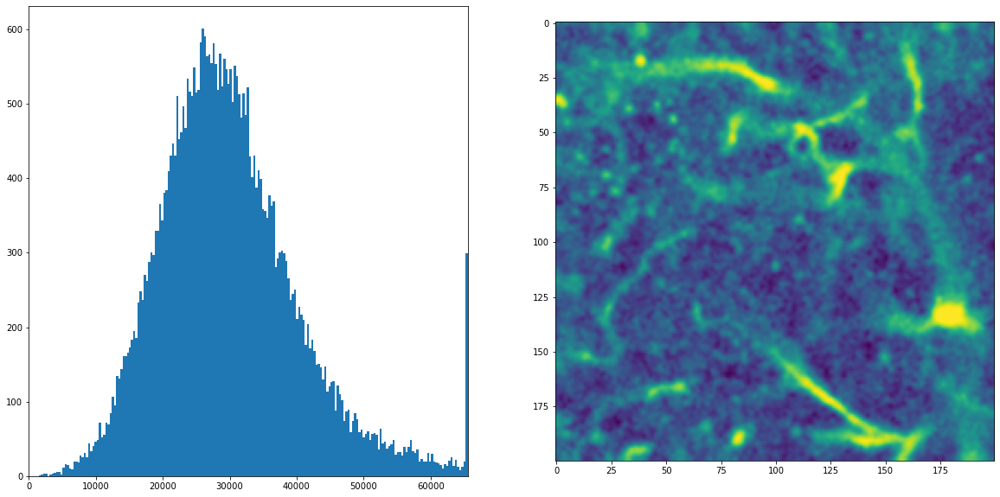

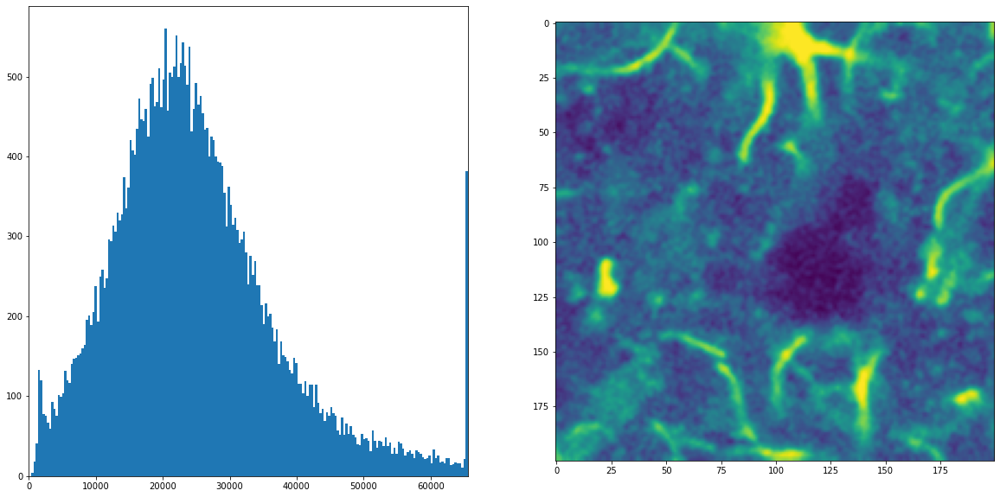

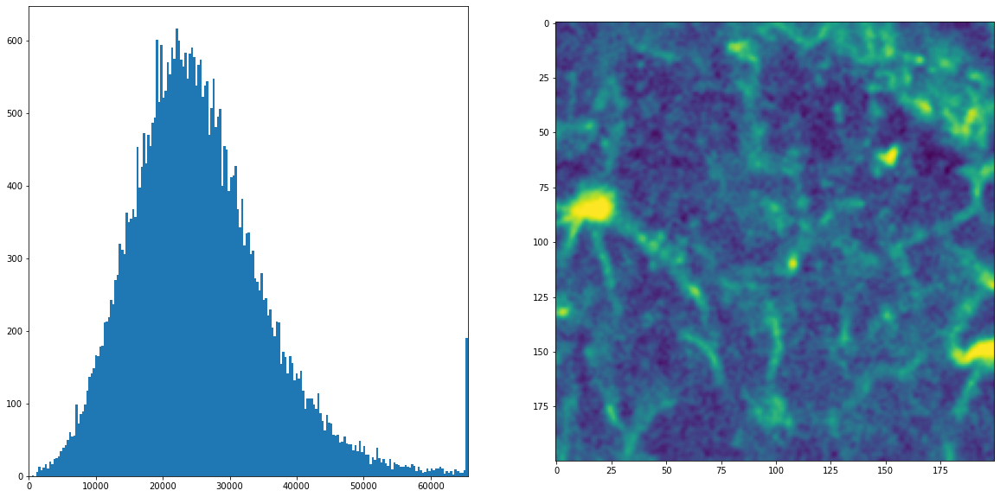

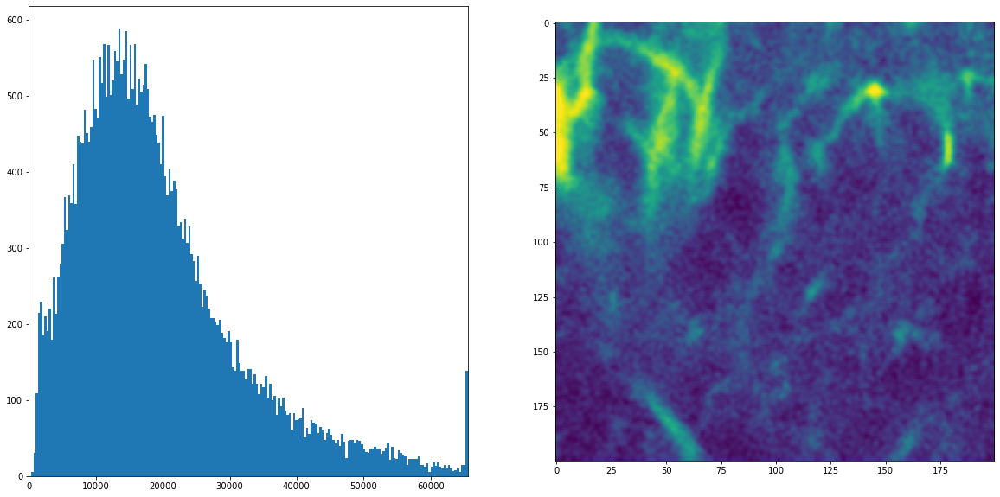

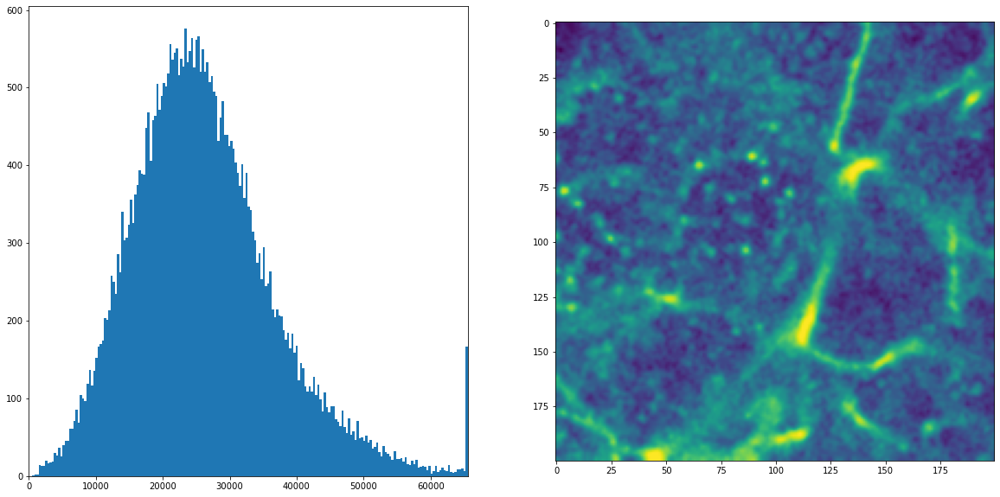

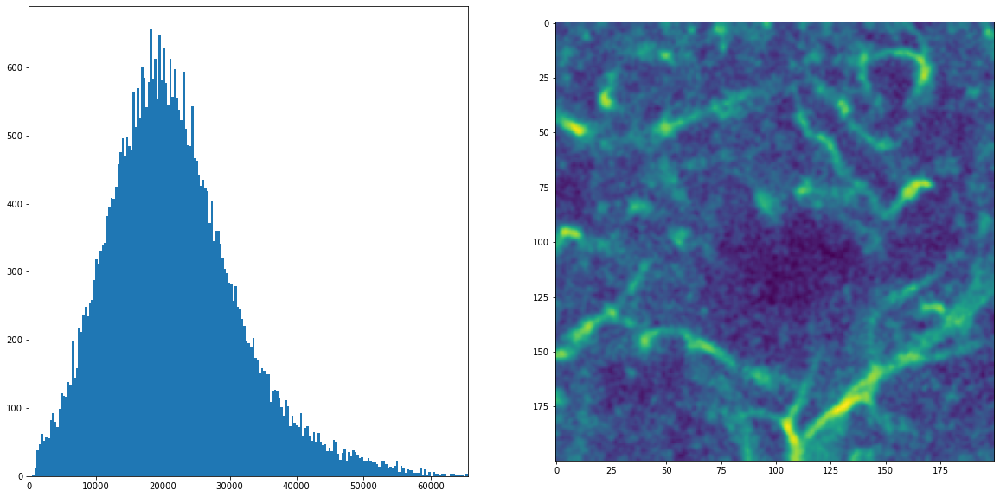

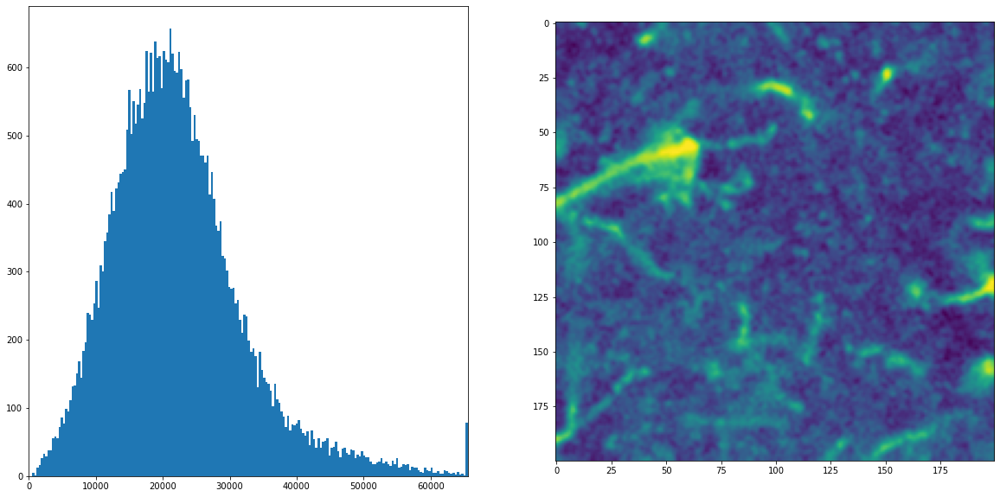

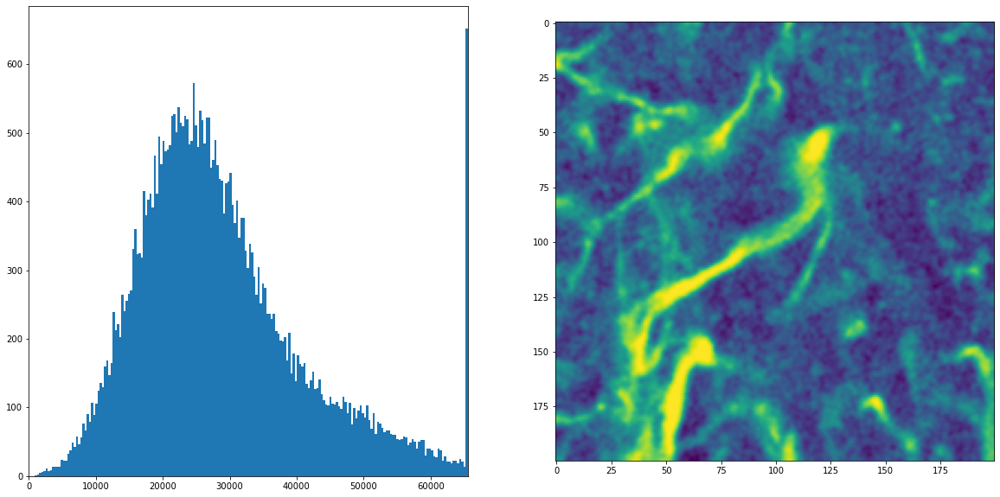

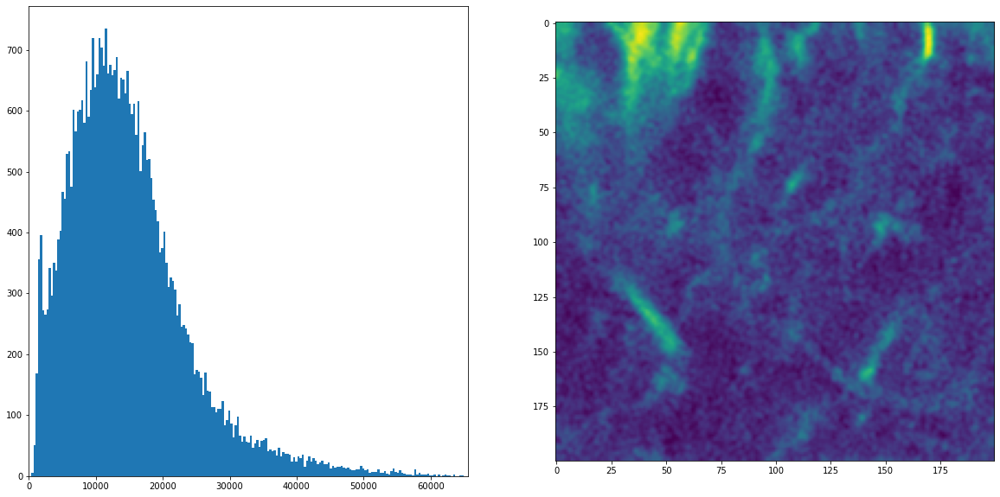

In [280]:
skeleton = im[tid, :, :]

cur = np.log(skeleton.astype('float64'))
cur -= cur.min()
mx = 2 ** 16 - 1
cur *= mx / np.quantile(cur.flatten(), 0.99)
cur = np.minimum(cur, mx)
cur = cur.astype('uint16')

w = 200
np.random.seed(42)
for k in range(10):
    x = np.random.randint(cur.shape[0] - w)
    y = np.random.randint(cur.shape[0] - w)
    plt.figure(figsize = (20, 10))
    plt.subplot(121)
    plt.hist(cur[x:x+w, y:y+w].flatten(), bins = 200)
    plt.xlim([0, mx])
    plt.subplot(122)
    imgx = cur[x:x+w, y:y+w].copy()
    imgx = cv2.GaussianBlur(imgx,(3,3),1)
    plt.imshow(imgx)
    #plt.yscale('log')
    #plt.xscale('log')
    pass

In [227]:
np.sum(cur < 255)

0

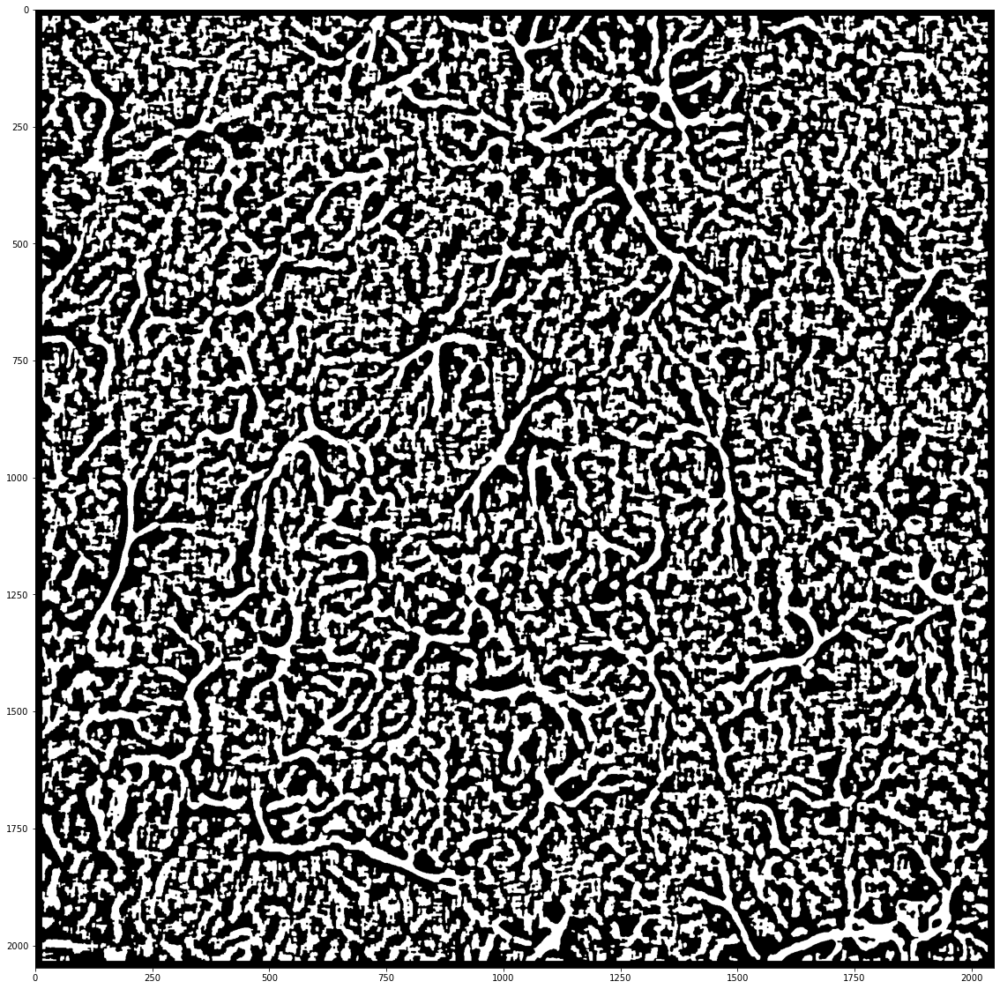

In [24]:
plt.figure(figsize = (20, 20))
plt.imshow(fil.mask, cmap='gray')


In [38]:
!pip install fil_finder

  Created wheel for fil-finder: filename=fil_finder-1.7-py3-none-any.whl size=1065139 sha256=07a1c73ef27821de87c4d9f6c8d3f313058880468bce9d97b667e3ce4607ffae
  Stored in directory: c:\users\mike_live\appdata\local\pip\cache\wheels\de\31\26\76152e4c3fe5795b42abb7190538f5423c0476d021fb0e37cd
Successfully built fil-finder


In [345]:
np.unique(cur)

array([0., 1.])

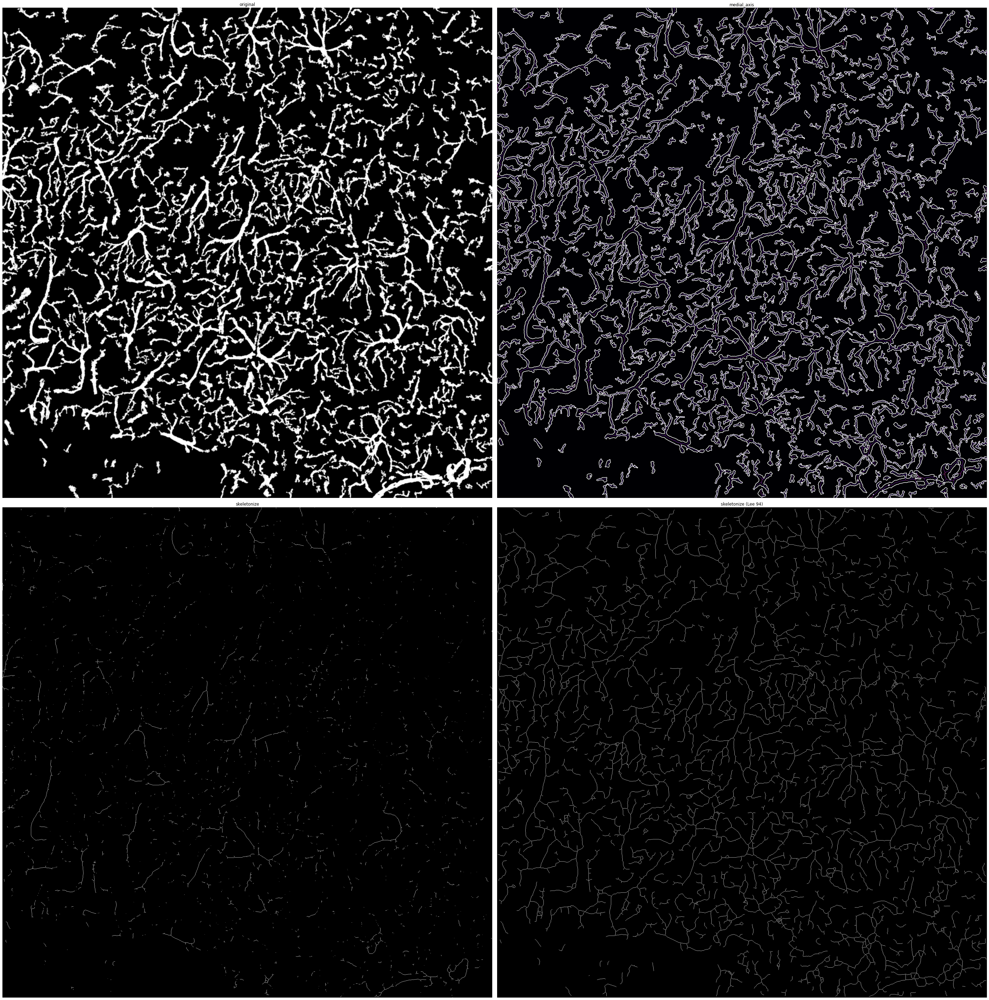

In [318]:
from skimage.morphology import medial_axis, skeletonize
from skimage import data

#blobs = im[tid, :500, :500].copy() > 3000
blobs = cur.copy()
blobs = cv2.GaussianBlur(blobs, (7, 7), 1)

# Compute the medial axis (skeleton) and the distance transform
skel, distance = medial_axis(blobs, return_distance=True)

# Compare with other skeletonization algorithms
skeleton = skeletonize(blobs)
skeleton_lee = skeletonize(blobs, method='lee')

# Distance to the background for pixels of the skeleton
dist_on_skel = distance * skel

fig, axes = plt.subplots(2, 2, figsize=(40, 40), sharex=True, sharey=True)
ax = axes.ravel()

ax[0].imshow(blobs, cmap=plt.cm.gray)
ax[0].set_title('original')
ax[0].axis('off')

ax[1].imshow(dist_on_skel, cmap='magma')
ax[1].contour(blobs, [0.5], colors='w')
ax[1].set_title('medial_axis')
ax[1].axis('off')

ax[2].imshow(skeleton, cmap=plt.cm.gray)
ax[2].set_title('skeletonize')
ax[2].axis('off')

ax[3].imshow(skeleton_lee, cmap=plt.cm.gray)
ax[3].set_title("skeletonize (Lee 94)")
ax[3].axis('off')

fig.tight_layout()
plt.show()

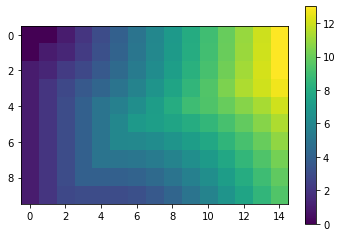

In [339]:
plt.imshow(distance[:10, 60:75])
plt.colorbar()

In [342]:
distance[4, 60:75].T

array([ 1.        ,  2.        ,  3.        ,  4.        ,  5.        ,
        5.65685425,  6.40312424,  7.21110255,  8.06225775,  8.94427191,
        9.43398113, 10.        , 10.63014581, 11.3137085 , 12.04159458])

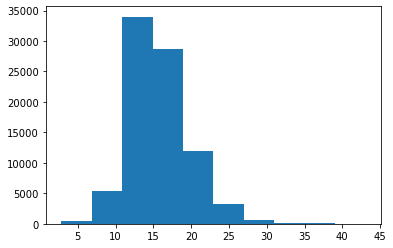

In [333]:
mult
plt.hist(distance[skeleton_lee != 0] * 2)
pass